<a href="https://colab.research.google.com/github/sravan277/mission_planner123/blob/main/detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [7]:
# Install YOLOv8
!pip install ultralytics --upgrade
import ultralytics
ultralytics.checks()

# If you get a warning on second run, ignore it.


Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 42.0/112.6 GB disk)


In [8]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [9]:
!unzip "/content/drive/My Drive/Mango Detection.zip" -d "/content/mango_dataset/"


Archive:  /content/drive/My Drive/Mango Detection.zip
replace /content/mango_dataset/README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace /content/mango_dataset/README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace /content/mango_dataset/data.yaml? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace /content/mango_dataset/train/images/frame_0_jpg.rf.b63fdca081c15a1825687dfcc54a168e.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace /content/mango_dataset/train/images/frame_11_jpg.rf.79ed7d367b4e5cc819828bf12222a0e7.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace /content/mango_dataset/train/images/frame_12_jpg.rf.a58b0b6173ad983712bd175b2a4c5f47.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
 extracting: /content/mango_dataset/train/images/frame_13_jpg.rf.376eca012aa2965c1ba78e616f836db6.jpg  
 extracting: /content/mango_dataset/train/images/frame_14_jpg.rf.27c48a4836bc55514b31df9dcc40bfe4.jpg  
 extracting: /content/mango_dataset/train/images/frame_15_jp

In [10]:
# Train the mango detection model
!yolo detect train data="/content/Mango Detection.v2i.yolov8/data.yaml" \
imgsz=640 \
epochs=150 \
batch=16 \
optimizer=SGD \
lr0=0.01 \
patience=15 \
augment=True \
hsv_h=0.015 hsv_s=0.7 hsv_v=0.4 degrees=0.0 translate=0.1 scale=0.5 shear=0.0 perspective=0.0 flipud=0 fliplr=0.5 mosaic=1.0 mixup=0.2 \
workers=4


Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/Mango Detection.v2i.yolov8/data.yaml, epochs=150, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=4, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes

In [11]:
# Check files
!ls  "/content/drive/My Drive/Mango Detection.zip"


'/content/drive/My Drive/Mango Detection.zip'


In [12]:
!ls "/content/Mango Detection"


ls: cannot access '/content/Mango Detection': No such file or directory


In [13]:
!unzip "/content/drive/My Drive/Mango Detection.zip" -d "/content/"


Archive:  /content/drive/My Drive/Mango Detection.zip
replace /content/README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [14]:
!ls "/content/Mango Detection"


ls: cannot access '/content/Mango Detection': No such file or directory


In [15]:
/content/train/images/    (with .jpg, .png images)
/content/train/labels/    (with .txt label files)
/content/data.yaml        (dataset config)


SyntaxError: invalid syntax (<ipython-input-15-6b13e07e6aeb>, line 1)

In [18]:
# Install YOLOv8
!pip install ultralytics --upgrade

# Import
from ultralytics import YOLO

# OPTIONAL: Check if GPU is available
import torch
print("CUDA Available:", torch.cuda.is_available())

# ✅ Path setup (your dataset is already organized under /content)
# /content/train/images/
# /content/train/labels/
# /content/data.yaml

# ✅ Let's check your dataset YAML file
!cat /content/data.yaml

# ✅ Create a YOLOv8 model (using pre-trained weights as a base)
model = YOLO('yolov8n.pt')   # or yolov8s.pt for a slightly bigger model

# ✅ Start Training
model.train(
    data='/content/data.yaml',  # dataset config
    epochs=100,                 # increase if you want even better accuracy
    imgsz=640,                  # image size
    batch=16,                   # adjust based on GPU memory
    patience=20,                # early stopping
    optimizer="SGD",            # or "Adam" or "AdamW"
    lr0=0.01,                   # learning rate
    device=0                    # 0 for GPU, 'cpu' for CPU
)

# ✅ After Training, let's test the model
metrics = model.val()

# ✅ Save the model
model.export(format='onnx')    # if you want ONNX export
model.export(format='torchscript')  # for TorchScript export

# ✅ Inference: Let's test on one of your own images
results = model.predict(source="/content/train/images/", save=True, conf=0.25)


# You can find predictions under "runs/detect/predict/" folder


CUDA Available: True
train: ../train/images
val: ../valid/images
test: ../test/images

nc: 1
names: ['Mango']

roboflow:
  workspace: sai-subhash
  project: mango-detection-tbihn
  version: 2
  license: CC BY 4.0
  url: https://universe.roboflow.com/sai-subhash/mango-detection-tbihn/dataset/2Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/data.yaml, epochs=10, time=None, patience=20, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train8, exist_ok=False, pretrained=True, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=N

train: Scanning /content/train/labels.cache... 67 images, 0 backgrounds, 0 corrupt: 100%|██████████| 67/67 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1800.9±2159.8 MB/s, size: 1844.4 KB)


val: Scanning /content/valid/labels.cache... 14 images, 0 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]


Plotting labels to runs/detect/train8/labels.jpg... 
optimizer: SGD(lr=0.01, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train8
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.56G      4.383      5.113      1.563        242        640: 100%|██████████| 5/5 [00:06<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.33it/s]

                   all         14       1025   0.000476    0.00195   0.000239   5.98e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.56G      3.999      4.587      1.469        172        640: 100%|██████████| 5/5 [00:04<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.74it/s]

                   all         14       1025   0.000238   0.000976    0.00012    3.6e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.79G      3.379      4.054      1.156        155        640: 100%|██████████| 5/5 [00:02<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         14       1025     0.0019     0.0078    0.00096   0.000228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.79G      3.297      3.853      1.042        232        640: 100%|██████████| 5/5 [00:04<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]

                   all         14       1025      0.005     0.0205    0.00256   0.000738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.79G      2.773      3.052     0.9643        172        640: 100%|██████████| 5/5 [00:02<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.08it/s]

                   all         14       1025    0.00929      0.038    0.00484    0.00114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.79G      2.767      2.538     0.9475        233        640: 100%|██████████| 5/5 [00:03<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         14       1025     0.0433      0.178     0.0339     0.0106



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.82G      2.678      2.065     0.9294        137        640: 100%|██████████| 5/5 [00:02<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all         14       1025      0.117      0.478      0.164     0.0484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.82G       2.71      1.882      0.932        127        640: 100%|██████████| 5/5 [00:03<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.79it/s]

                   all         14       1025      0.136      0.557      0.288      0.103



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.83G      2.472      1.663     0.9106        289        640: 100%|██████████| 5/5 [00:02<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         14       1025      0.138      0.565      0.352      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.83G      2.439      1.649     0.9033        239        640: 100%|██████████| 5/5 [00:02<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

                   all         14       1025       0.14      0.575      0.383      0.138



10 epochs completed in 0.017 hours.
Optimizer stripped from runs/detect/train8/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train8/weights/best.pt, 6.2MB

Validating runs/detect/train8/weights/best.pt...
Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


                   all         14       1025       0.14      0.572      0.382      0.138
Speed: 0.1ms preprocess, 5.4ms inference, 0.0ms loss, 37.8ms postprocess per image
Results saved to runs/detect/train8
Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3799.3±1383.5 MB/s, size: 1815.8 KB)


val: Scanning /content/valid/labels.cache... 14 images, 0 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.74s/it]


                   all         14       1025      0.139       0.57      0.381       0.14
Speed: 0.6ms preprocess, 4.4ms inference, 0.0ms loss, 17.3ms postprocess per image
Results saved to runs/detect/train82
Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CPU (Intel Xeon 2.20GHz)

PyTorch: starting from 'runs/detect/train8/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.50...
ONNX: export success ✅ 1.3s, saved as 'runs/detect/train8/weights/best.onnx' (11.7 MB)

Export complete (1.7s)
Results saved to /content/runs/detect/train8/weights
Predict:         yolo predict task=detect model=runs/detect/train8/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train8/weights/best.onnx imgsz=640 data=/content/data.yaml  
Visualize:       https://netron.app
Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CPU (Inte

In [21]:
!ls /content/runs/detect/*/weights/


/content/runs/detect/train2/weights/:

/content/runs/detect/train3/weights/:
best.pt  last.pt

/content/runs/detect/train4/weights/:
best.onnx  best.pt  best.torchscript  last.pt

/content/runs/detect/train5/weights/:

/content/runs/detect/train6/weights/:

/content/runs/detect/train7/weights/:
best.onnx  best.pt  best.torchscript  last.pt

/content/runs/detect/train8/weights/:
best.onnx  best.pt  best.torchscript  last.pt

/content/runs/detect/train/weights/:


In [22]:
from ultralytics import YOLO

# Load your trained model
model = YOLO('/content/runs/detect/train4/weights/best.pt')


# Predict on entire train images
results = model.predict(source="/content/train/images/", save=True, conf=0.25)

# Results will be saved to runs/detect/predict/



image 1/67 /content/train/images/frame_0_jpg.rf.b63fdca081c15a1825687dfcc54a168e.jpg: 384x640 72 Mangos, 7.5ms
image 2/67 /content/train/images/frame_11_jpg.rf.79ed7d367b4e5cc819828bf12222a0e7.jpg: 384x640 78 Mangos, 7.5ms
image 3/67 /content/train/images/frame_12_jpg.rf.a58b0b6173ad983712bd175b2a4c5f47.jpg: 384x640 73 Mangos, 8.0ms
image 4/67 /content/train/images/frame_13_jpg.rf.376eca012aa2965c1ba78e616f836db6.jpg: 384x640 76 Mangos, 7.2ms
image 5/67 /content/train/images/frame_14_jpg.rf.27c48a4836bc55514b31df9dcc40bfe4.jpg: 384x640 82 Mangos, 7.1ms
image 6/67 /content/train/images/frame_15_jpg.rf.2e5e9775336981a5405cf30e622e0967.jpg: 384x640 68 Mangos, 7.5ms
image 7/67 /content/train/images/frame_16_jpg.rf.9706e21c64c4a76f2bdbc0c6bacdf237.jpg: 384x640 68 Mangos, 7.4ms
image 8/67 /content/train/images/frame_17_jpg.rf.bbdf552582924325bddd59ab3395e222.jpg: 384x640 76 Mangos, 7.2ms
image 9/67 /content/train/images/frame_18_jpg.rf.548f8fc218841b5dc57bb0fb4482bcef.jpg: 384x640 79 Mangos

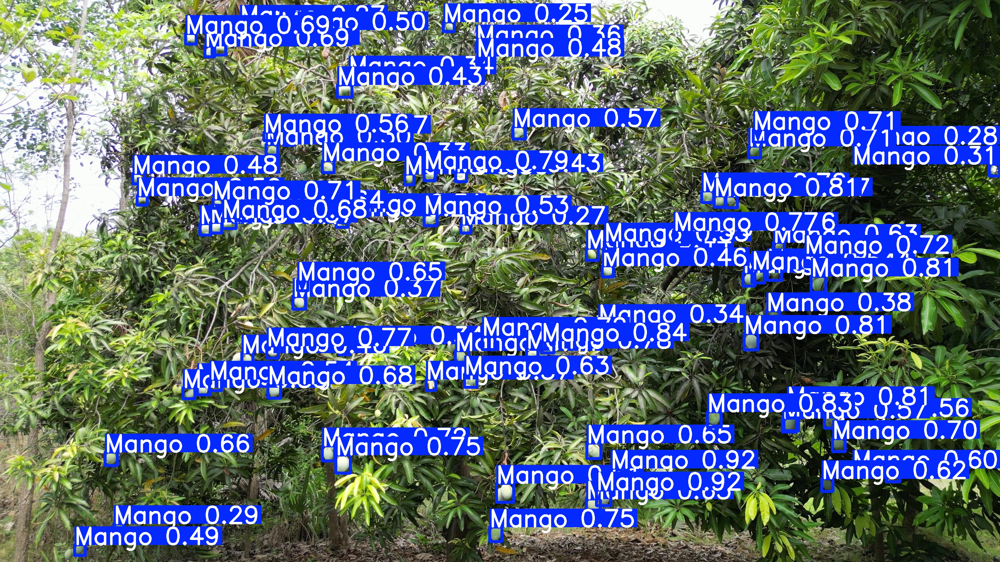

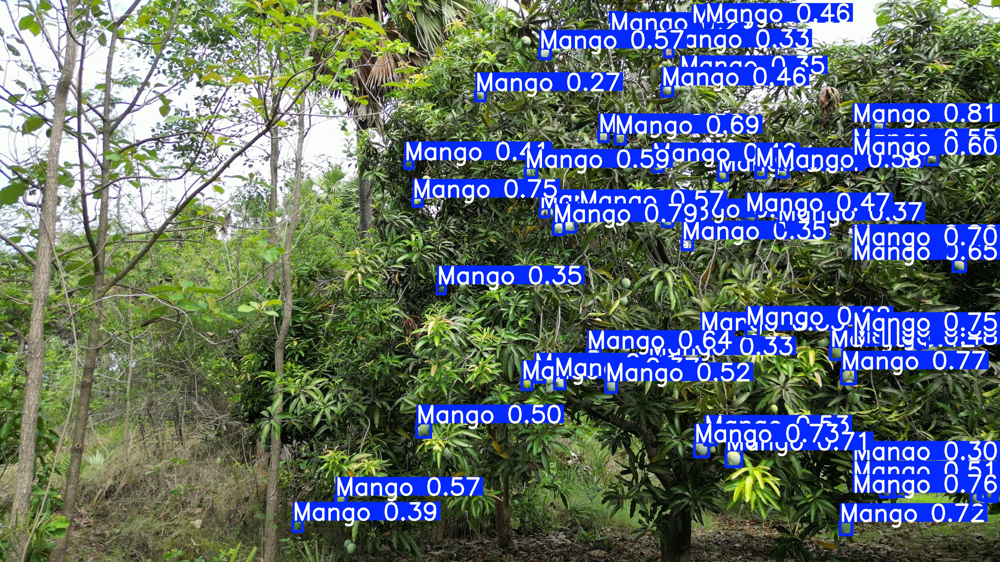

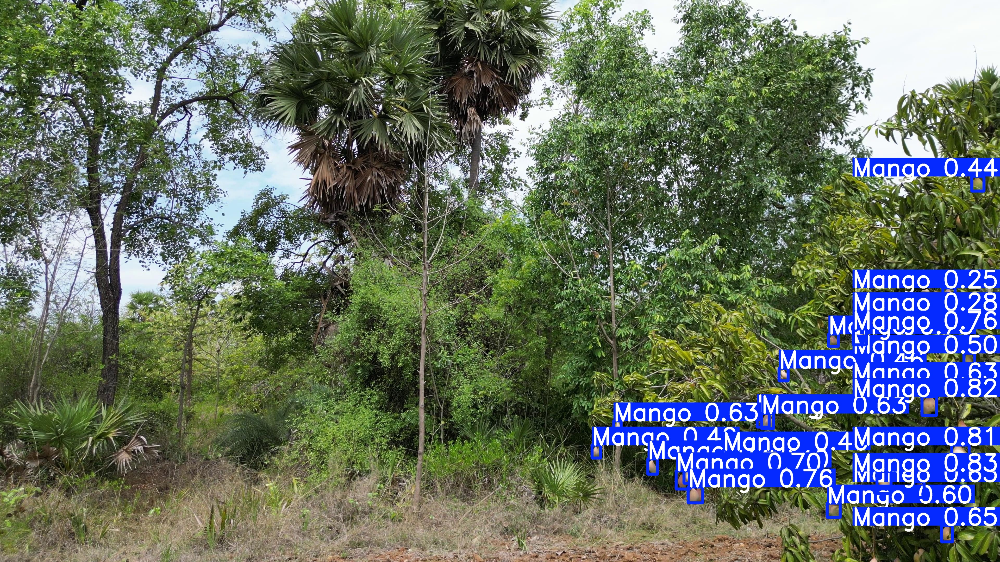

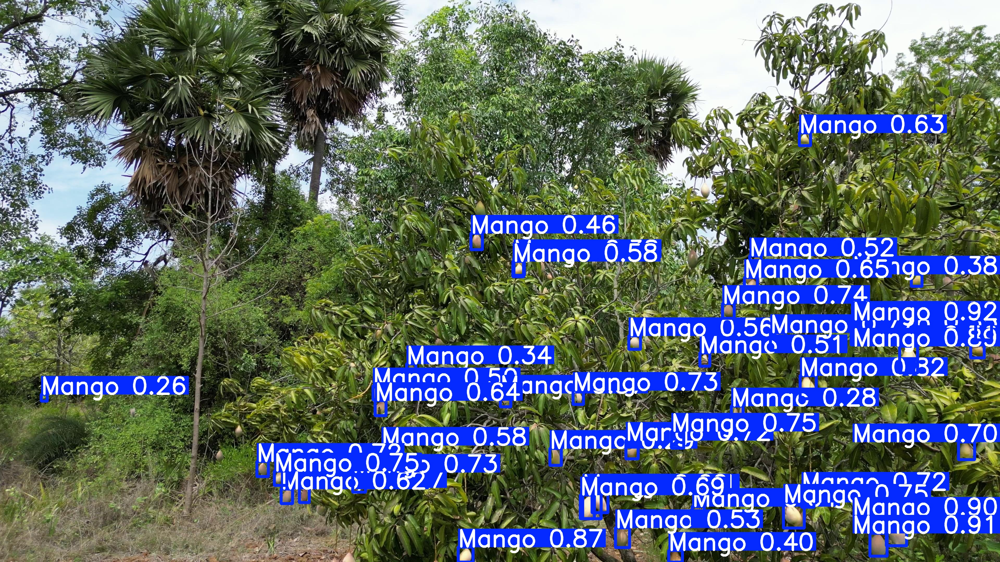

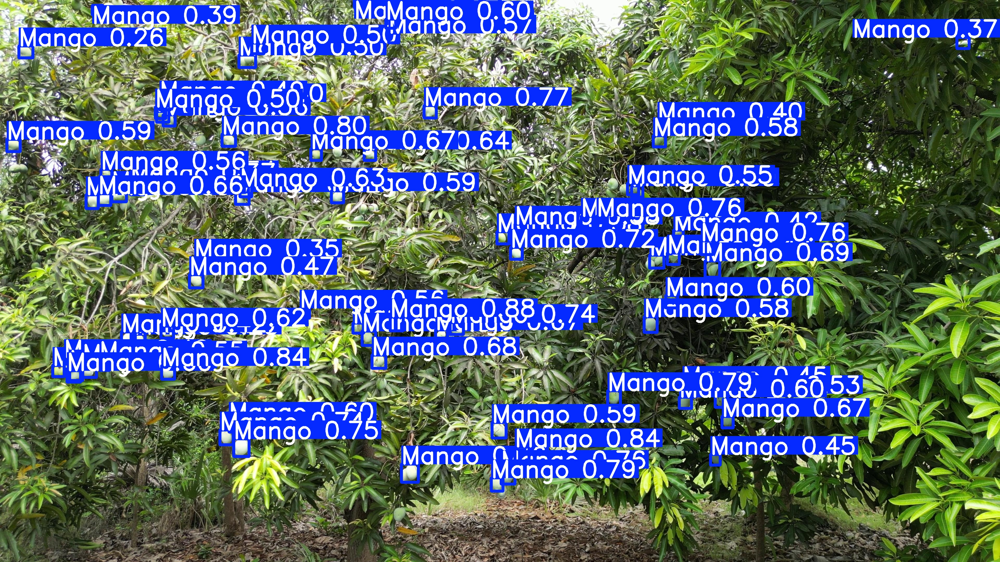

In [23]:
from IPython.display import Image, display
import glob

# Get list of all images predicted
predicted_images = glob.glob('/content/runs/detect/predict/*.jpg')

# Display a few predicted images
for img_path in predicted_images[:5]:  # Change number to show more
    display(Image(filename=img_path))


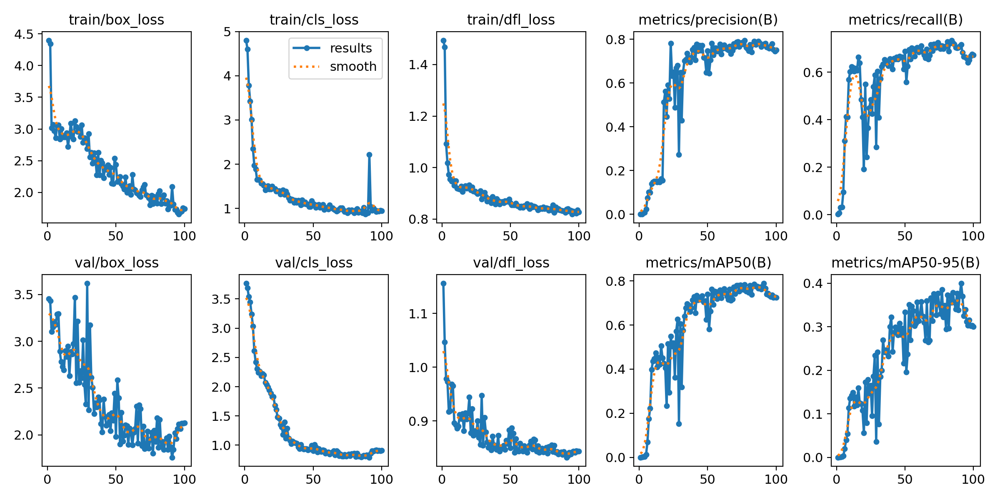

In [25]:
from IPython.display import Image, display

display(Image(filename='/content/runs/detect/train4/results.png'))


In [26]:
metrics = model.val()

print("📊 Evaluation Metrics:")
print(f"mAP@0.5       : {metrics.box.map50:.4f}")
print(f"mAP@0.5:0.95  : {metrics.box.map:.4f}")

Ultralytics 8.3.120 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3917.7±905.6 MB/s, size: 1803.3 KB)


val: Scanning /content/valid/labels.cache... 14 images, 0 backgrounds, 0 corrupt: 100%|██████████| 14/14 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.85s/it]


                   all         14       1025      0.801       0.71       0.79      0.404
Speed: 0.1ms preprocess, 3.5ms inference, 0.0ms loss, 4.1ms postprocess per image
Results saved to runs/detect/val
📊 Evaluation Metrics:
mAP@0.5       : 0.7901
mAP@0.5:0.95  : 0.4036


In [27]:
print("📊 Full metrics:")
print(metrics.results_dict)

📊 Full metrics:
{'metrics/precision(B)': np.float64(0.8008505256537923), 'metrics/recall(B)': np.float64(0.7101123840987571), 'metrics/mAP50(B)': np.float64(0.7901237822901038), 'metrics/mAP50-95(B)': np.float64(0.4036403869222226), 'fitness': np.float64(0.44228872645901074)}


In [28]:
results_dict = metrics.results_dict
print(f"Precision     : {results_dict['metrics/precision(B)']:.4f}")
print(f"Recall        : {results_dict['metrics/recall(B)']:.4f}")


Precision     : 0.8009
Recall        : 0.7101


In [29]:
from google.colab import files

# Upload your image
uploaded = files.upload()


Saving m5.jpg to m5.jpg


In [30]:
results = model.predict('/content/m5.jpg', save=True)



image 1/1 /content/m5.jpg: 384x640 73 Mangos, 8.5ms
Speed: 2.6ms preprocess, 8.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict


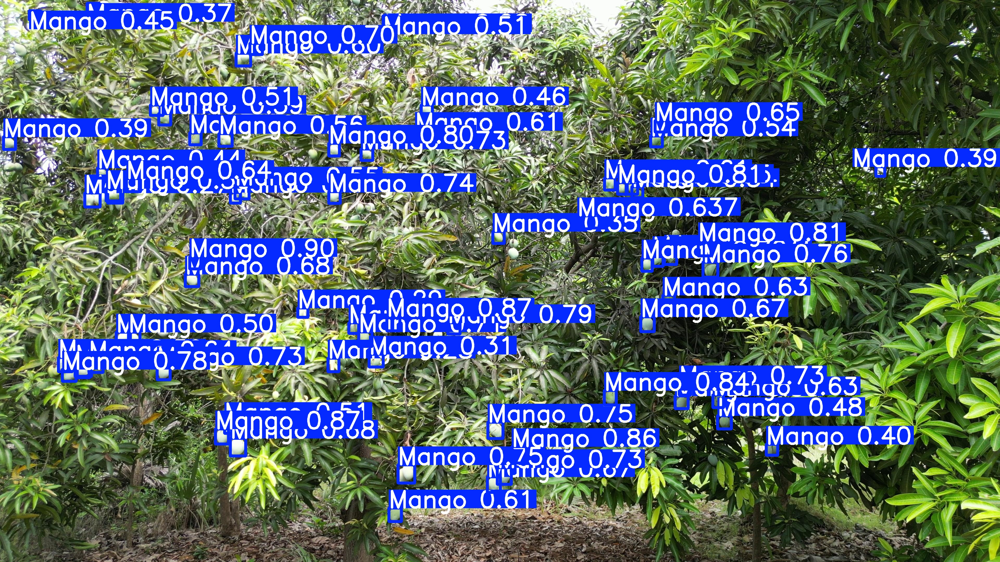

In [31]:

from IPython.display import Image, display

# Path to the saved detection result
display(Image(filename='runs/detect/predict/m5.jpg'))
